In [1]:
import pandas as pd

gw_data = pd.read_csv('GWTC_cleaned.csv')
gw_data

,id,commonName,version,catalog.shortName,GPS,reference,jsonurl,mass_1_source,mass_1_source_lower,mass_1_source_upper,...,redshift_upper,far,p_astro,final_mass_source,final_mass_source_lower,final_mass_source_upper,final_spin,final_spin_lower,final_spin_upper,sky_area_(deg^2)
0,GW150914-v3,GW150914,3,GWTC-2.1-confident,1.126259e+09,/GWTC-2.1/,https://gwosc.org/eventapi/json/GWTC-1-confide...,34.6,-2.6,4.4,...,0.03,1.000000e-07,1.00,61.5,-2.9,3.4,0.68,-0.05,0.05,250
1,GW151012-v3,GW151012,3,GWTC-2.1-confident,1.128679e+09,/GWTC-2.1/,https://gwosc.org/eventapi/json/GWTC-1-confide...,24.8,-6.3,14.5,...,0.11,7.920000e-03,1.00,37.1,-4.6,10.6,0.69,-0.13,0.13,"1,700"
2,GW151226-v2,GW151226,2,GWTC-2.1-confident,1.135136e+09,/GWTC-2.1/,https://gwosc.org/eventapi/json/GWTC-1-confide...,14.2,-3.6,11.1,...,0.03,1.000000e-07,1.00,20.5,-1.5,6.4,0.75,-0.05,0.12,950
3,GW170104-v2,GW170104,2,GWTC-2.1-confident,1.167560e+09,/GWTC-2.1/,https://gwosc.org/eventapi/json/GWTC-1-confide...,28.7,-4.2,6.6,...,0.07,1.000000e-07,1.00,47.5,-3.4,4.5,0.67,-0.08,0.06,"1,000"
4,GW170608-v3,GW170608,3,GWTC-2.1-confident,1.180922e+09,/GWTC-2.1/,https://gwosc.org/eventapi/json/GWTC-1-confide...,10.6,-1.4,4.0,...,0.03,1.000000e-07,1.00,17.7,-0.6,2.1,0.69,-0.03,0.03,380
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85,GW200306_093714-v1,GW200306_093714,1,GWTC-3-confident,1.267523e+09,/GWTC-3/,https://gwosc.org/eventapi/json/GWTC-3-confide...,28.3,-7.7,17.1,...,0.24,2.400000e+01,0.81,41.7,-6.9,12.3,0.78,-0.26,0.11,"4,600"
86,GW200308_173609-v1,GW200308_173609,1,GWTC-3-confident,1.267724e+09,/GWTC-3/,https://gwosc.org/eventapi/json/GWTC-3-confide...,60.0,-29.0,166.0,...,1.47,2.400000e+00,0.86,88.0,-47.0,169.0,0.72,-0.35,-0.22,"12,000"
87,GW200311_115853-v1,GW200311_115853,1,GWTC-3-confident,1.267963e+09,/GWTC-3/,https://gwosc.org/eventapi/json/GWTC-3-confide...,34.2,-3.8,6.4,...,0.05,1.000000e-05,0.99,59.0,-3.9,4.8,0.69,-0.08,0.07,35
88,GW200316_215756-v1,GW200316_215756,1,GWTC-3-confident,1.268431e+09,/GWTC-3/,https://gwosc.org/eventapi/json/GWTC-3-confide...,13.1,-2.9,10.2,...,0.08,1.000000e-05,0.99,20.2,-1.9,7.4,0.70,-0.04,0.04,190


In [2]:
events = [i for i in gw_data['commonName']]
events

['GW150914',
 'GW151012',
 'GW151226',
 'GW170104',
 'GW170608',
 'GW170729',
 'GW170809',
 'GW170814',
 'GW170817',
 'GW170818',
 'GW170823',
 'GW190403_051519',
 'GW190408_181802',
 'GW190412',
 'GW190413_052954',
 'GW190413_134308',
 'GW190421_213856',
 'GW190425',
 'GW190426_190642',
 'GW190503_185404',
 'GW190512_180714',
 'GW190513_205428',
 'GW190514_065416',
 'GW190517_055101',
 'GW190519_153544',
 'GW190521',
 'GW190521_074359',
 'GW190527_092055',
 'GW190602_175927',
 'GW190620_030421',
 'GW190630_185205',
 'GW190701_203306',
 'GW190706_222641',
 'GW190707_093326',
 'GW190708_232457',
 'GW190719_215514',
 'GW190720_000836',
 'GW190725_174728',
 'GW190727_060333',
 'GW190728_064510',
 'GW190731_140936',
 'GW190803_022701',
 'GW190805_211137',
 'GW190814',
 'GW190828_063405',
 'GW190828_065509',
 'GW190910_112807',
 'GW190915_235702',
 'GW190916_200658',
 'GW190917_114630',
 'GW190924_021846',
 'GW190925_232845',
 'GW190926_050336',
 'GW190929_012149',
 'GW190930_133541',
 'GW1

In [3]:
from gwosc.locate import get_event_urls
import urllib.request

# Collect URLs containing 32s of strain data for each event 
all_urls = []

for event in events:
    url_list = get_event_urls(event, duration=32, detector='H1')
    
    # If no URL for detector 'H1', get the URL for detector 'L1'
    if not url_list:
        url_list = get_event_urls(event, duration=32, detector='L1')
    
    all_urls.extend(url_list)   
    
# Download strain data for all events
def download(url):
    filename = events[i] + '.hdf5'
    print('Downloading ' + url )
    urllib.request.urlretrieve(url, filename)  
    print("File download complete:", filename)
    return filename 

for i in range(len(events)):
    url = all_urls[i]
    download(url)    

File download complete: GW150914.hdf5
File download complete: GW151012.hdf5
File download complete: GW151226.hdf5
File download complete: GW170104.hdf5
File download complete: GW170608.hdf5
File download complete: GW170729.hdf5
File download complete: GW170809.hdf5
File download complete: GW170814.hdf5
File download complete: GW170817.hdf5
File download complete: GW170818.hdf5
File download complete: GW170823.hdf5
File download complete: GW190403_051519.hdf5
File download complete: GW190408_181802.hdf5
File download complete: GW190412.hdf5
File download complete: GW190413_052954.hdf5
File download complete: GW190413_134308.hdf5
File download complete: GW190421_213856.hdf5
File download complete: GW190425.hdf5
File download complete: GW190426_190642.hdf5
File download complete: GW190503_185404.hdf5
File download complete: GW190512_180714.hdf5
File download complete: GW190513_205428.hdf5
File download complete: GW190514_065416.hdf5
File download complete: GW190517_055101.hdf5
File downlo

File download complete: GW190925_232845.hdf5
File download complete: GW190926_050336.hdf5
File download complete: GW190929_012149.hdf5
File download complete: GW190930_133541.hdf5
File download complete: GW191103_012549.hdf5
File download complete: GW191105_143521.hdf5
File download complete: GW191109_010717.hdf5
File download complete: GW191113_071753.hdf5
File download complete: GW191126_115259.hdf5
File download complete: GW191127_050227.hdf5
File download complete: GW191129_134029.hdf5
File download complete: GW191204_110529.hdf5
File download complete: GW191204_171526.hdf5
File download complete: GW191215_223052.hdf5
File download complete: GW191216_213338.hdf5
File download complete: GW191219_163120.hdf5
File download complete: GW191222_033537.hdf5
File download complete: GW191230_180458.hdf5
File download complete: GW200112_155838.hdf5
File download complete: GW200115_042309.hdf5
File download complete: GW200128_022011.hdf5
File download complete: GW200129_065458.hdf5
File downl

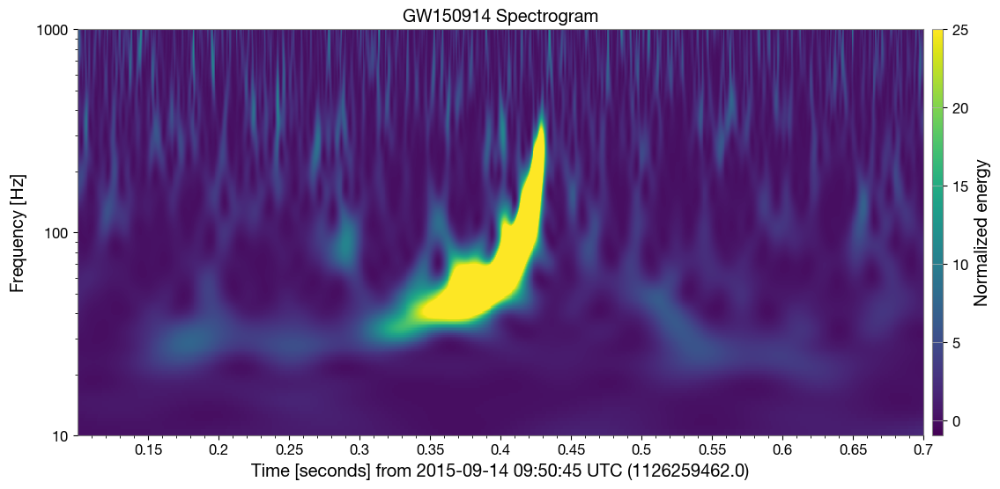

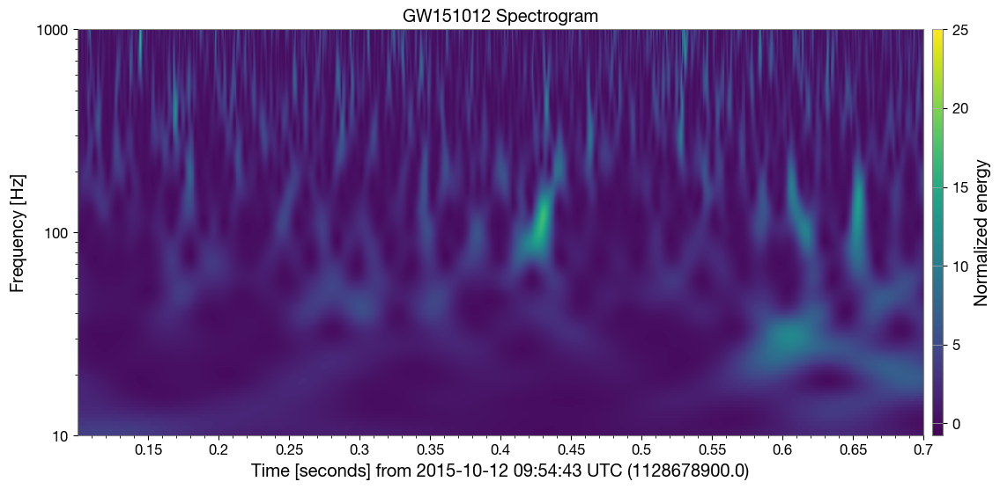

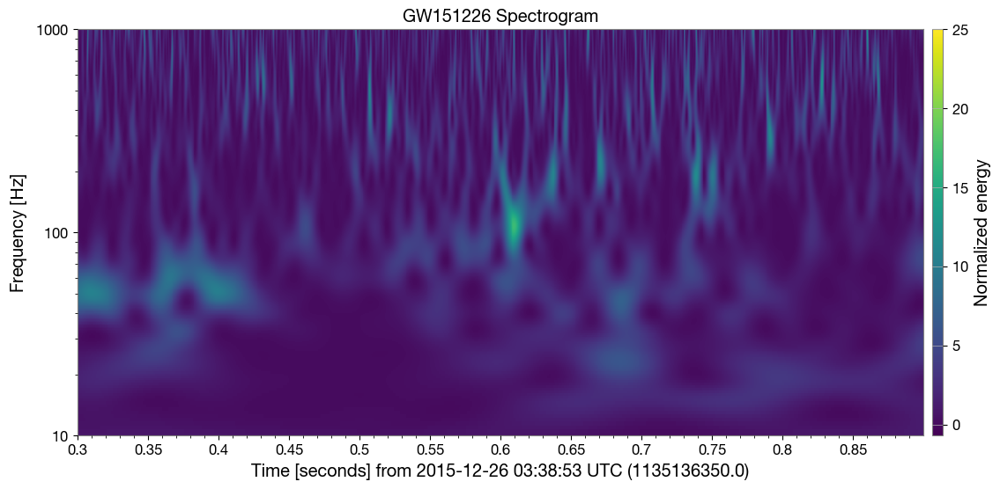

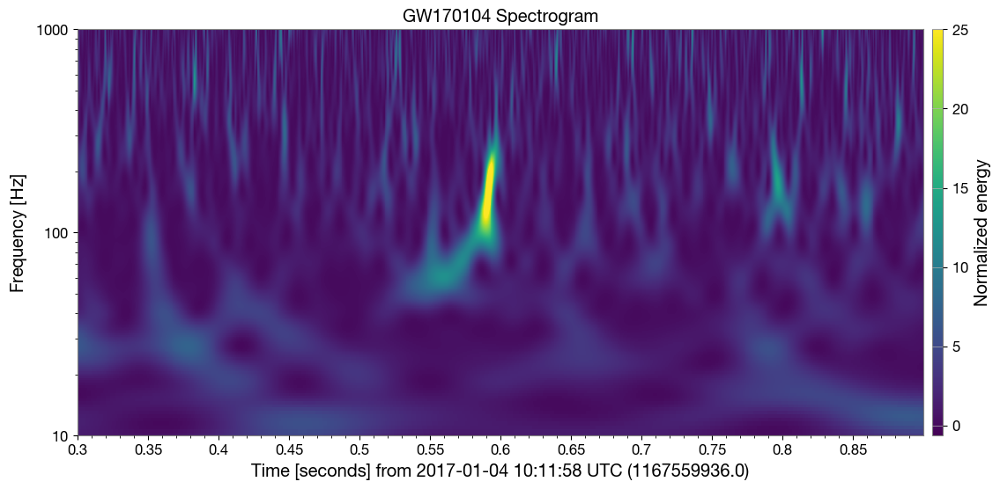

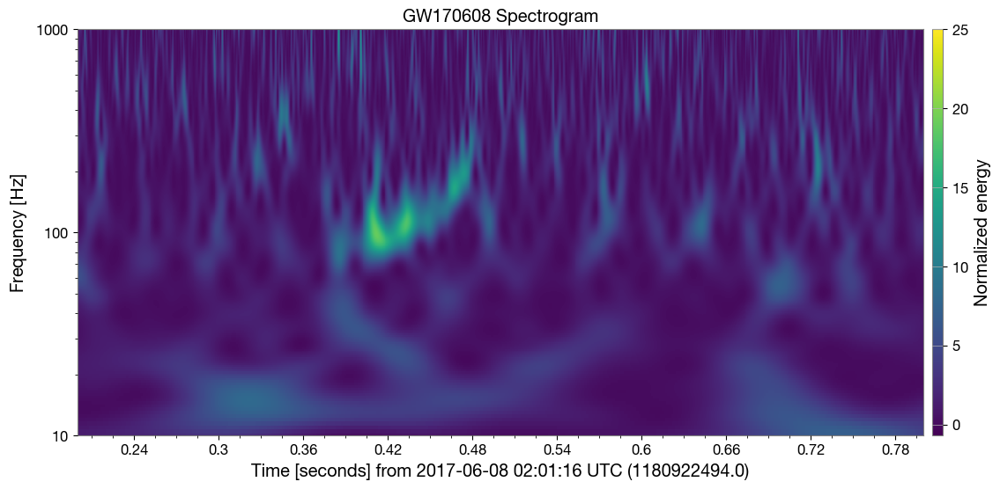

...

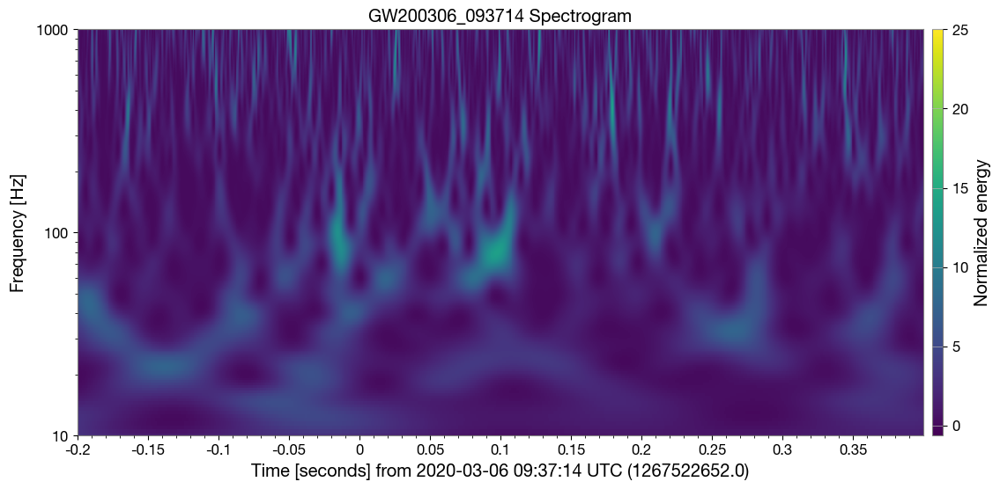

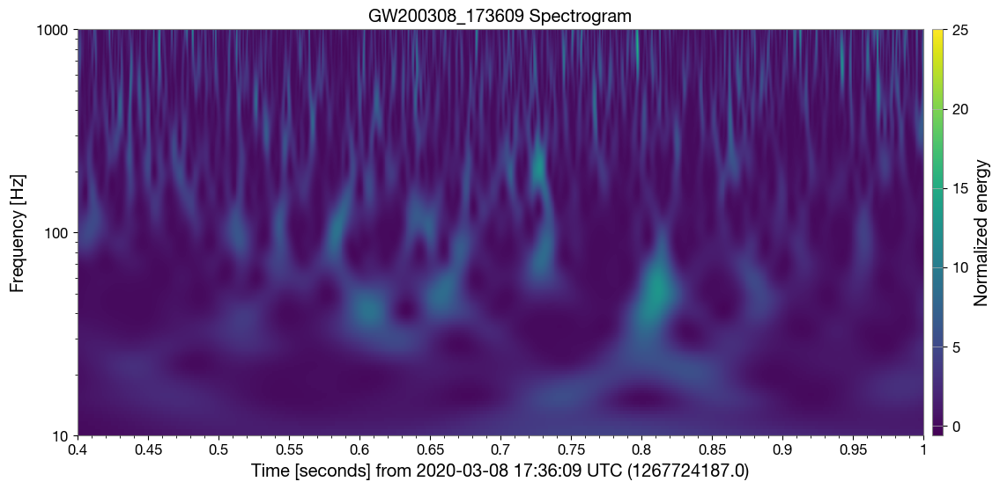

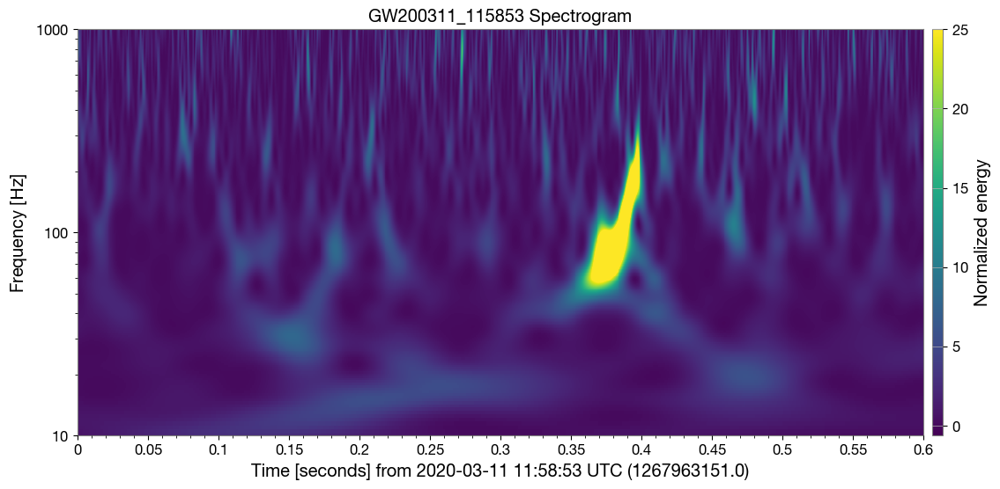

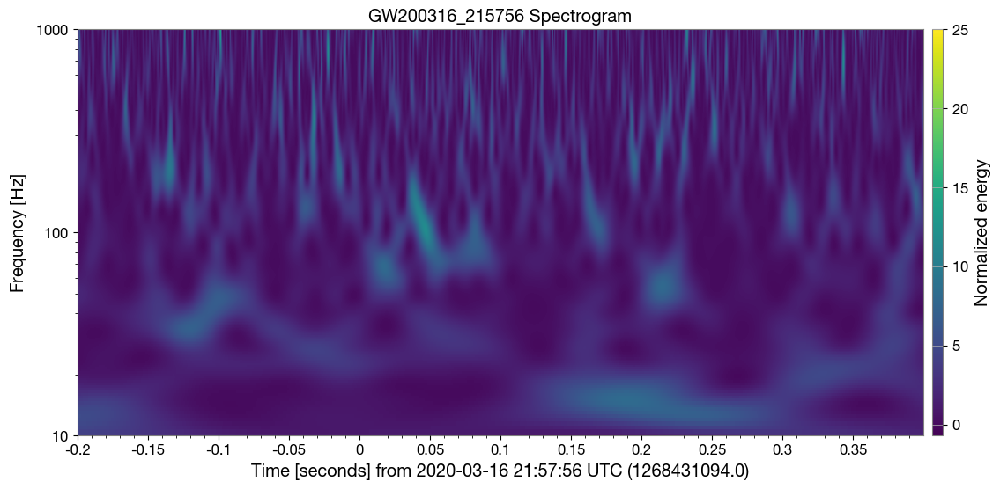

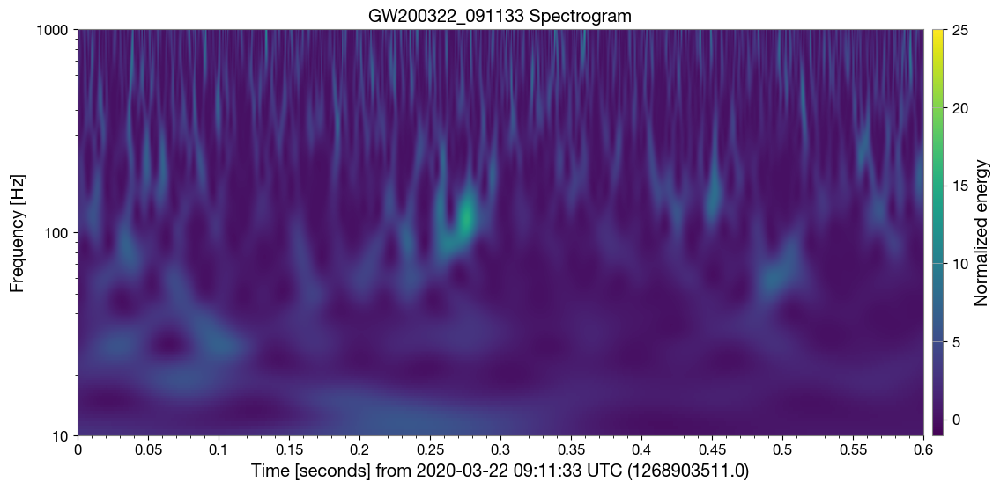

In [4]:
from gwpy.timeseries import TimeSeries
from gwosc.datasets import event_gps
import matplotlib.pyplot as plt

# Function that will create a spectrogram for any of the events
def q_plots(event):
    
    filepath = 'HDF5 files/' + event + '.hdf5'
    strain = TimeSeries.read(filepath, format='hdf5.gwosc')
    gps = event_gps(event)

    q = strain.q_transform(outseg=(gps-0.3, gps+0.3), qrange = (5,5))
    spectrogram = q.plot()
    ax = spectrogram.gca()
    spectrogram.colorbar(label="Normalized energy", vmax = 25)
    ax.grid(False)
    ax.set_yscale('log')
    ax.set_ylim(bottom=10, top=1000)
    plt.title(event + ' Spectrogram')
    
    plt.show()
    
# Plotting spectrograms for all events    
for event in events:
    q_plots(event)